# **Importing all necessary libraries**

In [ ]:
import warnings
warnings.simplefilter('ignore')
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import cv2
from sklearn.utils import shuffle
import os

# **Saving real images into array**

In [ ]:
img_size=64
n_channels=3
n_images=60000
noise_dim=512
working_dir='/kaggle/input/animefacedataset/images/'
images=np.zeros(shape=(n_images,img_size,img_size,n_channels))
i=0
for image in os.listdir(working_dir):
    if i%10==0:
        print(i)
    if i<n_images:
        img=cv2.imread(working_dir+image)
        img=cv2.resize(img,(img_size,img_size))
        img=cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
        images[i]=img
        i+=1
    else:
        break
np.random.shuffle(images)
images/=255
print(images.shape)

0
10
20
30
40
50
60
70
80
90
100
110
120
130
140
150
160
170
180
190
200
210
220
230
240
250
260
270
280
290
300
310
320
330
340
350
360
370
380
390
400
410
420
430
440
450
460
470
480
490
500
510
520
530
540
550
560
570
580
590
600
610
620
630
640
650
660
670
680
690
700
710
720
730
740
750
760
770
780
790
800
810
820
830
840
850
860
870
880
890
900
910
920
930
940
950
960
970
980
990
1000
1010
1020
1030
1040
1050
1060
1070
1080
1090
1100
1110
1120
1130
1140
1150
1160
1170
1180
1190
1200
1210
1220
1230
1240
1250
1260
1270
1280
1290
1300
1310
1320
1330
1340
1350
1360
1370
1380
1390
1400
1410
1420
1430
1440
1450
1460
1470
1480
1490
1500
1510
1520
1530
1540
1550
1560
1570
1580
1590
1600
1610
1620
1630
1640
1650
1660
1670
1680
1690
1700
1710
1720
1730
1740
1750
1760
1770
1780
1790
1800
1810
1820
1830
1840
1850
1860
1870
1880
1890
1900
1910
1920
1930
1940
1950
1960
1970
1980
1990
2000
2010
2020
2030
2040
2050
2060
2070
2080
2090
2100
2110
2120
2130
2140
2150
2160
2170
2180
2190
2200
2210
2

# **Visualizing some images from dataset**

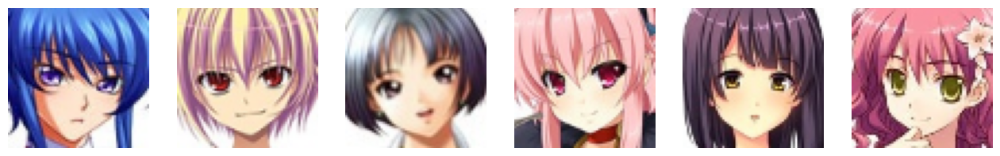

In [ ]:
fig=plt.figure(figsize=(16,16))
for i in range(6):
    ax=fig.add_subplot(1,6,i+1)
    ax.axis('off')
    ax.imshow(images[i])
plt.show()

# **Defining Generator and Discriminator**

In [ ]:
Discriminator=tf.keras.Sequential([tf.keras.layers.Input(shape=(img_size,img_size,n_channels)),
                                   tf.keras.layers.Conv2D(filters=64,kernel_size=(4,4),strides=(1,1),padding='same',activation=tf.keras.layers.LeakyReLU(0.2)),
                                   tf.keras.layers.MaxPooling2D(pool_size=(2,2)),
                                   tf.keras.layers.Conv2D(filters=128,kernel_size=(4,4),strides=(1,1),padding='same',activation=tf.keras.layers.LeakyReLU(0.2)),
                                   tf.keras.layers.MaxPooling2D(pool_size=(2,2)),
                                   tf.keras.layers.Flatten(),
                                   tf.keras.layers.Dropout(0.9),
                                   tf.keras.layers.Dense(units=128,activation=tf.keras.layers.LeakyReLU(0.01)),
                                   tf.keras.layers.Dropout(0.05),
                                   tf.keras.layers.Dense(units=1,activation='sigmoid')],name='Discriminator')
Discriminator.summary()

Model: "Discriminator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 64, 64, 64)        3136      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 32, 32, 64)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 32, 32, 128)       131200    
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 16, 16, 128)      0         
 2D)                                                             
                                                                 
 flatten (Flatten)           (None, 32768)             0         
                                                                 
 dropout (Dropout)           (None, 32768)           

In [ ]:
Generator=tf.keras.Sequential([tf.keras.Input(shape=(noise_dim)),
                               tf.keras.layers.Dense(units=32768,activation=tf.keras.layers.LeakyReLU(0.1)),
                               tf.keras.layers.Reshape(target_shape=(8,8,512)),
                               tf.keras.layers.BatchNormalization(),
                               tf.keras.layers.Conv2DTranspose(filters=256,kernel_size=(4,4),strides=(2,2),padding='same',name='TC1',activation=tf.keras.layers.LeakyReLU(0.2)),
                               tf.keras.layers.Conv2DTranspose(filters=128,kernel_size=(4,4),strides=(2,2),padding='same',name='TC2',activation=tf.keras.layers.LeakyReLU(0.2)),
                               tf.keras.layers.Conv2DTranspose(filters=64,kernel_size=(4,4),strides=(2,2),padding='same',name='TC3',activation=tf.keras.layers.LeakyReLU(0.2)),
                               tf.keras.layers.Conv2D(filters=3,kernel_size=(2,2),strides=(1,1),padding='same',name='F',activation='sigmoid')],name='Generator')
Generator.summary()

Model: "Generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_2 (Dense)             (None, 32768)             16809984  
                                                                 
 reshape (Reshape)           (None, 8, 8, 512)         0         
                                                                 
 batch_normalization (BatchN  (None, 8, 8, 512)        2048      
 ormalization)                                                   
                                                                 
 TC1 (Conv2DTranspose)       (None, 16, 16, 256)       2097408   
                                                                 
 TC2 (Conv2DTranspose)       (None, 32, 32, 128)       524416    
                                                                 
 TC3 (Conv2DTranspose)       (None, 64, 64, 64)        131136    
                                                         

# **Defining generator's and discriminators's loss functions**

In [ ]:
def discriminator_loss(real_pred,fake_pred):
    real_loss=tf.keras.losses.BinaryCrossentropy(from_logits=True)(tf.ones_like(real_pred),real_pred)
    fake_loss=tf.keras.losses.BinaryCrossentropy(from_logits=True)(tf.zeros_like(fake_pred),fake_pred)
    total_loss=(real_loss+fake_loss)/2
    return total_loss

In [ ]:
def generator_loss(fake_pred):
    loss=tf.keras.losses.BinaryCrossentropy(from_logits=True)(tf.ones_like(fake_pred),fake_pred)
    return loss

# **Defining Adversarial Model**

In [ ]:
class GAN(tf.keras.Model):
    def __init__(self,generator,discriminator,latent_dim):
        super(GAN,self).__init__()
        self.generator=generator
        self.discriminator=discriminator
        self.latent_dim=latent_dim
        self.g_loss_metric=tf.keras.metrics.Mean(name='g_loss')
        self.d_loss_metric=tf.keras.metrics.Mean(name='d_loss')
        self.g_accuracy_metric=tf.keras.metrics.Mean(name='g_accuracy')
        self.d_accuracy_metric=tf.keras.metrics.Mean(name='d_accuracy')
        self.accuracy=tf.keras.metrics.Accuracy()
    @property
    def metrics(self):
        return [self.g_loss_metric,self.d_loss_metric,self.g_accuracy_metric,self.d_accuracy_metric]
    def compile(self,gen_loss,dis_loss,gen_opt,dis_opt):
        super(GAN,self).compile()
        self.gen_loss=gen_loss
        self.dis_loss=dis_loss
        self.gen_opt=gen_opt
        self.dis_opt=dis_opt
    def train_step(self,real_images):
        batch_size=tf.shape(real_images)[0]
        noise=tf.random.normal(shape=(batch_size,self.latent_dim),seed=None)
        with tf.GradientTape() as d_tape:
            pred_real=self.discriminator(real_images,training=True)
            fake_images=self.generator(noise)
            pred_fake=self.discriminator(fake_images,training=True)
            d_loss=self.dis_loss(pred_real,pred_fake)
        d_accuracy=0
        self.accuracy.update_state(y_true=tf.ones_like(pred_real),y_pred=tf.round(pred_real))
        d_accuracy+=self.accuracy.result()
        self.accuracy.reset_state()
        self.accuracy.update_state(y_true=tf.zeros_like(pred_fake),y_pred=tf.round(pred_fake))
        d_accuracy+=self.accuracy.result()
        self.accuracy.reset_state()
        d_accuracy/=2
        gradients=d_tape.gradient(d_loss,self.discriminator.trainable_variables)
        self.dis_opt.apply_gradients(zip(gradients,self.discriminator.trainable_variables))
        with tf.GradientTape() as g_tape:
            fake_images=self.generator(noise,training=True)
            pred_fake=self.discriminator(fake_images,training=False)
            g_loss=self.gen_loss(pred_fake)
        self.accuracy.update_state(y_true=tf.ones_like(pred_fake),y_pred=tf.round(pred_fake))
        g_accuracy=self.accuracy.result()
        self.accuracy.reset_state()
        gradients=g_tape.gradient(g_loss,self.generator.trainable_variables)
        self.gen_opt.apply_gradients(zip(gradients,self.generator.trainable_variables))
        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)
        self.d_accuracy_metric.update_state(d_accuracy)
        self.g_accuracy_metric.update_state(g_accuracy)
        return {'d_loss':self.d_loss_metric.result(),'g_loss':self.g_loss_metric.result(),'d_accuracy':self.d_accuracy_metric.result(),'g_accuracy':self.g_accuracy_metric.result()}

# **Defining Callback, which will print examples of generated images after each learning epoch**

In [ ]:
class GANMonitor(tf.keras.callbacks.Callback):
    def __init__(self,latent_dim,num_imgs=6):
        self.num_imgs=num_imgs
        self.latent_dim=latent_dim
        self.noise=tf.random.normal(mean=0,stddev=1,shape=[self.num_imgs,self.latent_dim])
    def on_epoch_end(self,epoch,logs=None):
        g_img=self.model.generator(self.noise)
        g_img.numpy()
        fig=plt.figure(figsize=(16,16))
        for i in range(self.num_imgs):
            plt.subplot(1,self.num_imgs,i+1)
            img=tf.keras.preprocessing.image.array_to_img(g_img[i])
            plt.imshow(img)
            plt.axis('off')
        plt.show()
    def on_train_end(self,logs=None):
        self.model.generator.save('generator.h5')

# **Learning adversarial model**

Epoch 1/40
469/469 [==============================] - ETA: 0s - d_loss: 0.5829 - g_loss: 1.0222 - d_accuracy: 0.6540 - g_accuracy: 0.2493

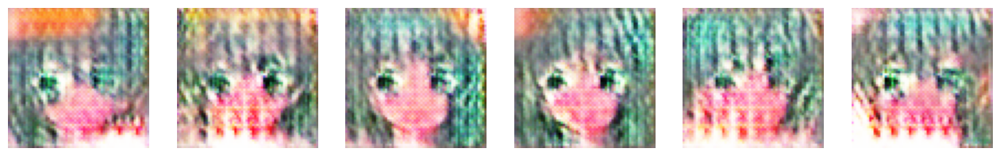

469/469 [==============================] - 86s 155ms/step - d_loss: 0.5829 - g_loss: 1.0222 - d_accuracy: 0.6540 - g_accuracy: 0.2493
Epoch 2/40
469/469 [==============================] - ETA: 0s - d_loss: 0.6849 - g_loss: 0.7787 - d_accuracy: 0.5478 - g_accuracy: 0.1114

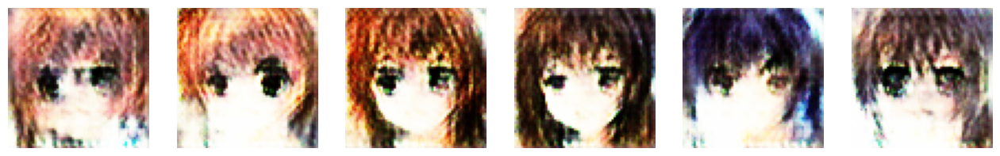

469/469 [==============================] - 72s 153ms/step - d_loss: 0.6849 - g_loss: 0.7787 - d_accuracy: 0.5478 - g_accuracy: 0.1114
Epoch 3/40
469/469 [==============================] - ETA: 0s - d_loss: 0.6883 - g_loss: 0.7393 - d_accuracy: 0.5362 - g_accuracy: 0.1570

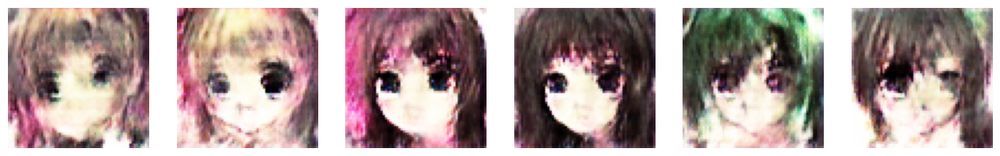

469/469 [==============================] - 72s 153ms/step - d_loss: 0.6883 - g_loss: 0.7393 - d_accuracy: 0.5362 - g_accuracy: 0.1570
Epoch 4/40
469/469 [==============================] - ETA: 0s - d_loss: 0.6874 - g_loss: 0.7252 - d_accuracy: 0.5317 - g_accuracy: 0.2490

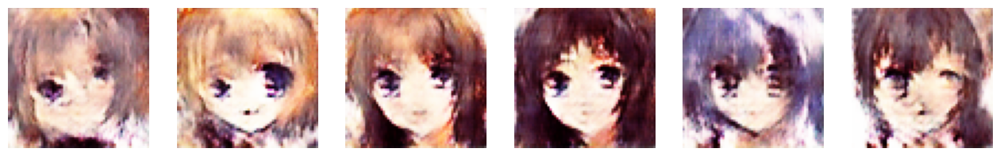

469/469 [==============================] - 72s 153ms/step - d_loss: 0.6874 - g_loss: 0.7252 - d_accuracy: 0.5317 - g_accuracy: 0.2490
Epoch 5/40
469/469 [==============================] - ETA: 0s - d_loss: 0.6891 - g_loss: 0.7216 - d_accuracy: 0.5314 - g_accuracy: 0.2301

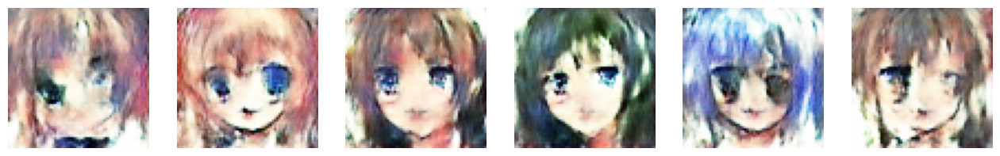

469/469 [==============================] - 72s 152ms/step - d_loss: 0.6891 - g_loss: 0.7216 - d_accuracy: 0.5314 - g_accuracy: 0.2301
Epoch 6/40
469/469 [==============================] - ETA: 0s - d_loss: 0.6910 - g_loss: 0.7112 - d_accuracy: 0.5273 - g_accuracy: 0.3328

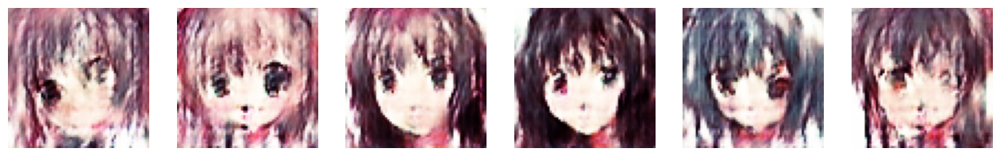

469/469 [==============================] - 72s 153ms/step - d_loss: 0.6910 - g_loss: 0.7112 - d_accuracy: 0.5273 - g_accuracy: 0.3328
Epoch 7/40
469/469 [==============================] - ETA: 0s - d_loss: 0.6915 - g_loss: 0.7025 - d_accuracy: 0.5166 - g_accuracy: 0.3883

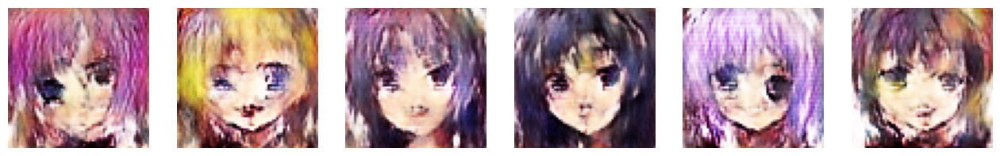

469/469 [==============================] - 72s 153ms/step - d_loss: 0.6915 - g_loss: 0.7025 - d_accuracy: 0.5166 - g_accuracy: 0.3883
Epoch 8/40
469/469 [==============================] - ETA: 0s - d_loss: 0.6906 - g_loss: 0.7097 - d_accuracy: 0.5256 - g_accuracy: 0.2654

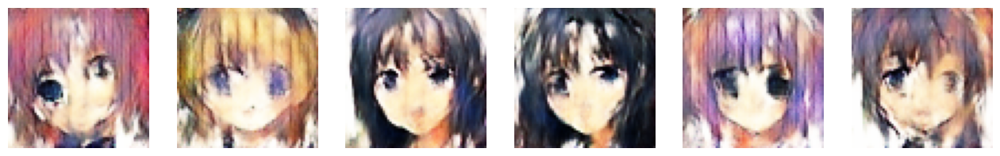

469/469 [==============================] - 72s 153ms/step - d_loss: 0.6906 - g_loss: 0.7097 - d_accuracy: 0.5256 - g_accuracy: 0.2654
Epoch 9/40
469/469 [==============================] - ETA: 0s - d_loss: 0.6928 - g_loss: 0.7055 - d_accuracy: 0.5085 - g_accuracy: 0.3087

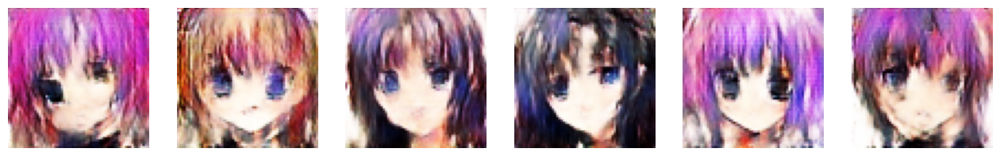

469/469 [==============================] - 72s 153ms/step - d_loss: 0.6928 - g_loss: 0.7055 - d_accuracy: 0.5085 - g_accuracy: 0.3087
Epoch 10/40
469/469 [==============================] - ETA: 0s - d_loss: 0.6920 - g_loss: 0.7030 - d_accuracy: 0.5181 - g_accuracy: 0.2856

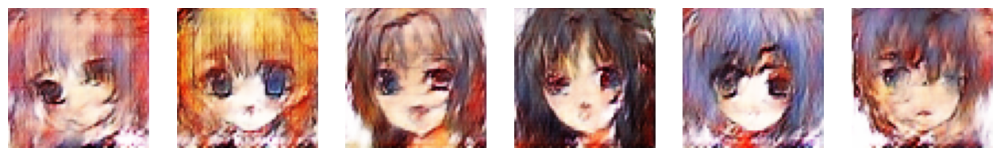

469/469 [==============================] - 72s 153ms/step - d_loss: 0.6920 - g_loss: 0.7030 - d_accuracy: 0.5181 - g_accuracy: 0.2856
Epoch 11/40
469/469 [==============================] - ETA: 0s - d_loss: 0.6923 - g_loss: 0.6986 - d_accuracy: 0.5125 - g_accuracy: 0.3324

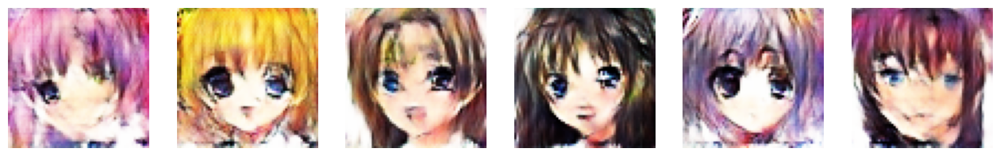

469/469 [==============================] - 72s 153ms/step - d_loss: 0.6923 - g_loss: 0.6986 - d_accuracy: 0.5125 - g_accuracy: 0.3324
Epoch 12/40
469/469 [==============================] - ETA: 0s - d_loss: 0.6923 - g_loss: 0.6999 - d_accuracy: 0.5122 - g_accuracy: 0.2300

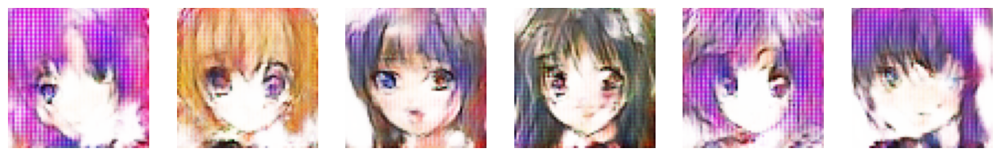

469/469 [==============================] - 72s 153ms/step - d_loss: 0.6923 - g_loss: 0.6999 - d_accuracy: 0.5122 - g_accuracy: 0.2300
Epoch 13/40
469/469 [==============================] - ETA: 0s - d_loss: 0.6928 - g_loss: 0.7018 - d_accuracy: 0.5087 - g_accuracy: 0.2858

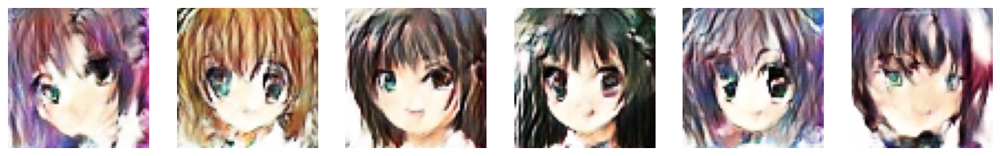

469/469 [==============================] - 71s 152ms/step - d_loss: 0.6928 - g_loss: 0.7018 - d_accuracy: 0.5087 - g_accuracy: 0.2858
Epoch 14/40
469/469 [==============================] - ETA: 0s - d_loss: 0.6930 - g_loss: 0.6997 - d_accuracy: 0.5061 - g_accuracy: 0.2043

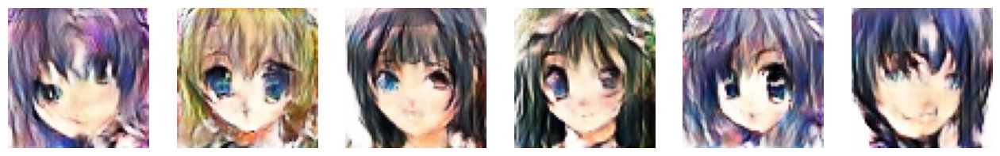

469/469 [==============================] - 71s 152ms/step - d_loss: 0.6930 - g_loss: 0.6997 - d_accuracy: 0.5061 - g_accuracy: 0.2043
Epoch 15/40
469/469 [==============================] - ETA: 0s - d_loss: 0.6931 - g_loss: 0.6983 - d_accuracy: 0.5049 - g_accuracy: 0.2479

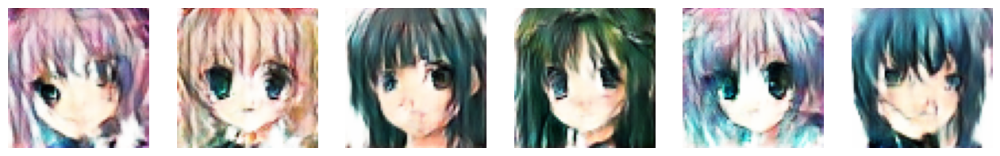

469/469 [==============================] - 72s 153ms/step - d_loss: 0.6931 - g_loss: 0.6983 - d_accuracy: 0.5049 - g_accuracy: 0.2479
Epoch 16/40
469/469 [==============================] - ETA: 0s - d_loss: 0.6929 - g_loss: 0.6970 - d_accuracy: 0.5053 - g_accuracy: 0.2793

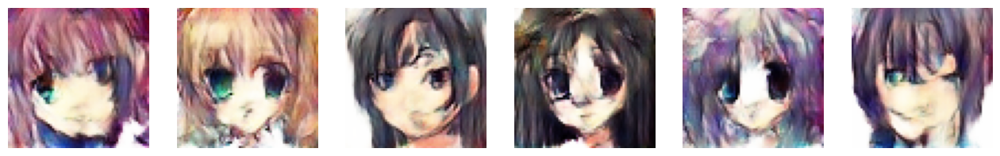

469/469 [==============================] - 72s 153ms/step - d_loss: 0.6929 - g_loss: 0.6970 - d_accuracy: 0.5053 - g_accuracy: 0.2793
Epoch 17/40
469/469 [==============================] - ETA: 0s - d_loss: 0.6938 - g_loss: 0.7016 - d_accuracy: 0.4961 - g_accuracy: 0.3033

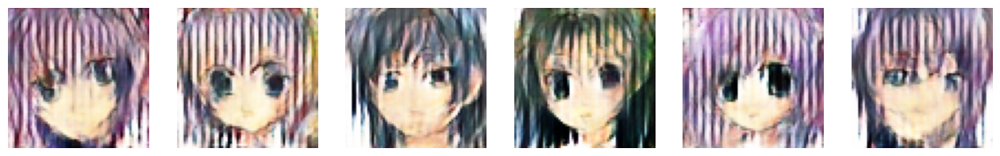

469/469 [==============================] - 72s 153ms/step - d_loss: 0.6938 - g_loss: 0.7016 - d_accuracy: 0.4961 - g_accuracy: 0.3033
Epoch 18/40
469/469 [==============================] - ETA: 0s - d_loss: 0.6931 - g_loss: 0.6937 - d_accuracy: 0.5036 - g_accuracy: 0.4391

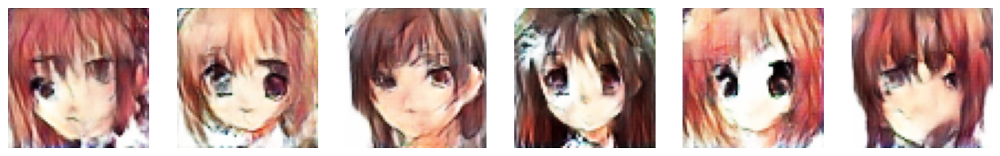

469/469 [==============================] - 71s 152ms/step - d_loss: 0.6931 - g_loss: 0.6937 - d_accuracy: 0.5036 - g_accuracy: 0.4391
Epoch 19/40
469/469 [==============================] - ETA: 0s - d_loss: 0.6928 - g_loss: 0.6989 - d_accuracy: 0.5108 - g_accuracy: 0.2928

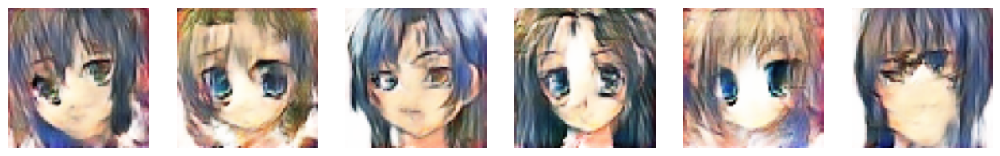

469/469 [==============================] - 71s 152ms/step - d_loss: 0.6928 - g_loss: 0.6989 - d_accuracy: 0.5108 - g_accuracy: 0.2928
Epoch 20/40
469/469 [==============================] - ETA: 0s - d_loss: 0.6930 - g_loss: 0.6984 - d_accuracy: 0.5085 - g_accuracy: 0.2507

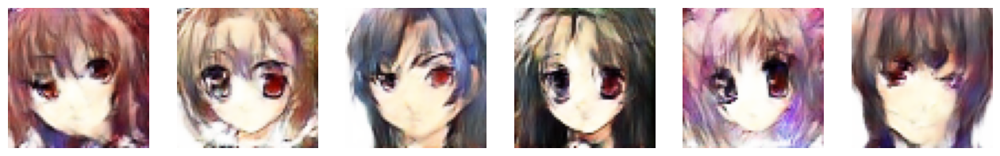

469/469 [==============================] - 71s 152ms/step - d_loss: 0.6930 - g_loss: 0.6984 - d_accuracy: 0.5085 - g_accuracy: 0.2507
Epoch 21/40
469/469 [==============================] - ETA: 0s - d_loss: 0.6931 - g_loss: 0.6979 - d_accuracy: 0.5021 - g_accuracy: 0.1918

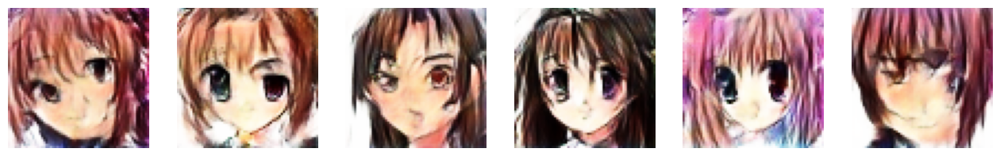

469/469 [==============================] - 72s 153ms/step - d_loss: 0.6931 - g_loss: 0.6979 - d_accuracy: 0.5021 - g_accuracy: 0.1918
Epoch 22/40
469/469 [==============================] - ETA: 0s - d_loss: 0.6930 - g_loss: 0.6957 - d_accuracy: 0.5020 - g_accuracy: 0.2756

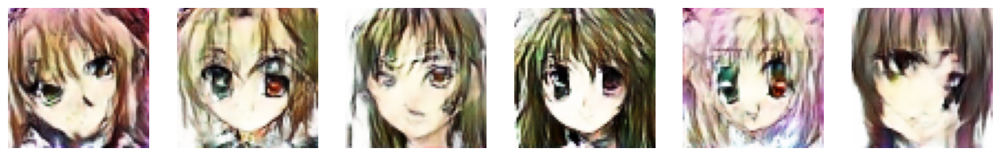

469/469 [==============================] - 71s 152ms/step - d_loss: 0.6930 - g_loss: 0.6957 - d_accuracy: 0.5020 - g_accuracy: 0.2756
Epoch 23/40
469/469 [==============================] - ETA: 0s - d_loss: 0.6929 - g_loss: 0.6951 - d_accuracy: 0.5014 - g_accuracy: 0.2874

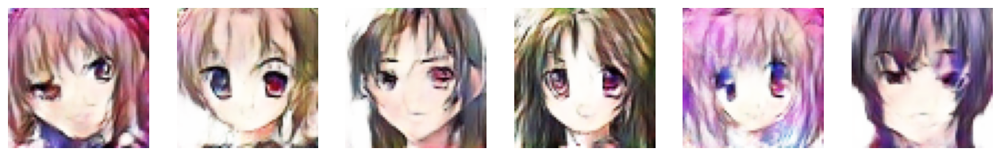

469/469 [==============================] - 72s 152ms/step - d_loss: 0.6929 - g_loss: 0.6951 - d_accuracy: 0.5014 - g_accuracy: 0.2874
Epoch 24/40
469/469 [==============================] - ETA: 0s - d_loss: 0.6929 - g_loss: 0.6953 - d_accuracy: 0.5052 - g_accuracy: 0.2914

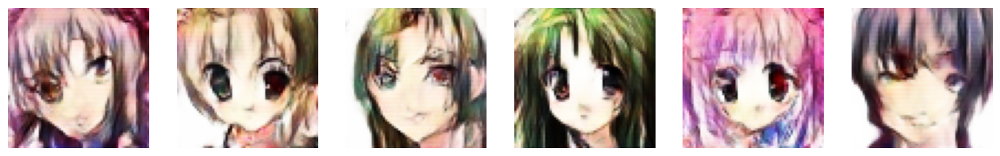

469/469 [==============================] - 71s 152ms/step - d_loss: 0.6929 - g_loss: 0.6953 - d_accuracy: 0.5052 - g_accuracy: 0.2914
Epoch 25/40
469/469 [==============================] - ETA: 0s - d_loss: 0.6431 - g_loss: 1.0918 - d_accuracy: 0.6182 - g_accuracy: 0.1435

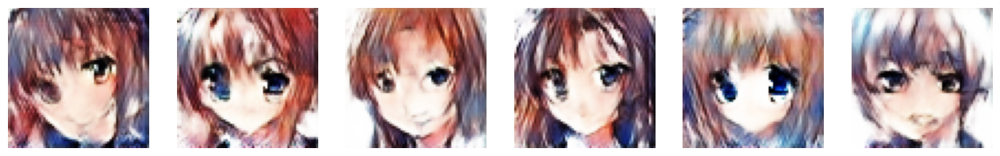

469/469 [==============================] - 71s 152ms/step - d_loss: 0.6431 - g_loss: 1.0918 - d_accuracy: 0.6182 - g_accuracy: 0.1435
Epoch 26/40
469/469 [==============================] - ETA: 0s - d_loss: 0.6619 - g_loss: 0.8074 - d_accuracy: 0.6037 - g_accuracy: 0.1173

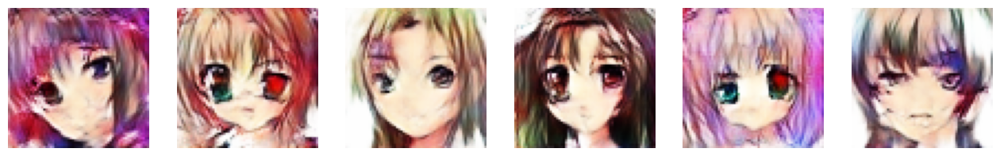

469/469 [==============================] - 71s 152ms/step - d_loss: 0.6619 - g_loss: 0.8074 - d_accuracy: 0.6037 - g_accuracy: 0.1173
Epoch 27/40
469/469 [==============================] - ETA: 0s - d_loss: 0.6787 - g_loss: 0.7383 - d_accuracy: 0.5660 - g_accuracy: 0.1985

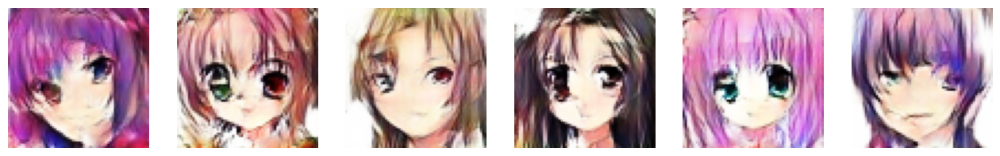

469/469 [==============================] - 72s 152ms/step - d_loss: 0.6787 - g_loss: 0.7383 - d_accuracy: 0.5660 - g_accuracy: 0.1985
Epoch 28/40
469/469 [==============================] - ETA: 0s - d_loss: 0.6851 - g_loss: 0.7111 - d_accuracy: 0.5499 - g_accuracy: 0.2735

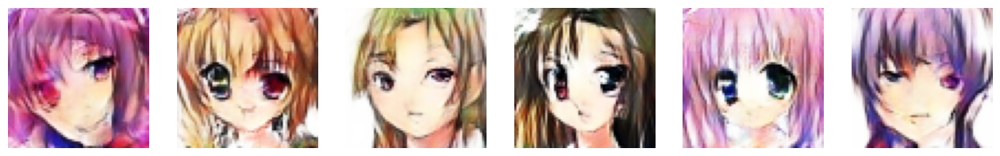

469/469 [==============================] - 72s 152ms/step - d_loss: 0.6851 - g_loss: 0.7111 - d_accuracy: 0.5499 - g_accuracy: 0.2735
Epoch 29/40
469/469 [==============================] - ETA: 0s - d_loss: 0.6873 - g_loss: 0.7042 - d_accuracy: 0.5418 - g_accuracy: 0.3182

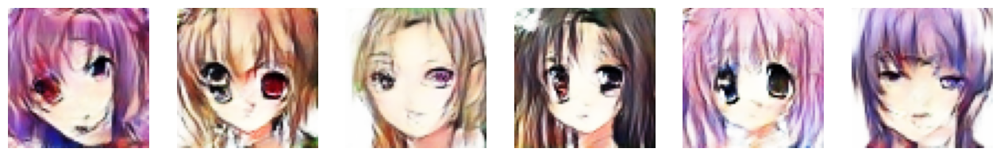

469/469 [==============================] - 72s 153ms/step - d_loss: 0.6873 - g_loss: 0.7042 - d_accuracy: 0.5418 - g_accuracy: 0.3182
Epoch 30/40
469/469 [==============================] - ETA: 0s - d_loss: 0.6884 - g_loss: 0.6993 - d_accuracy: 0.5374 - g_accuracy: 0.3603

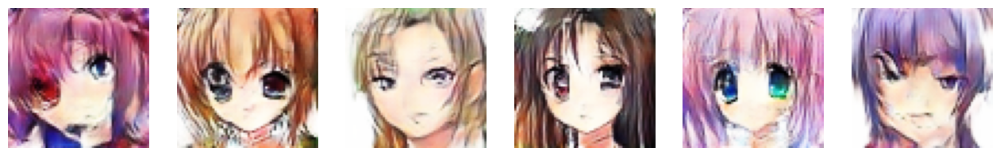

469/469 [==============================] - 72s 153ms/step - d_loss: 0.6884 - g_loss: 0.6993 - d_accuracy: 0.5374 - g_accuracy: 0.3603
Epoch 31/40
469/469 [==============================] - ETA: 0s - d_loss: 0.6893 - g_loss: 0.6970 - d_accuracy: 0.5311 - g_accuracy: 0.3819

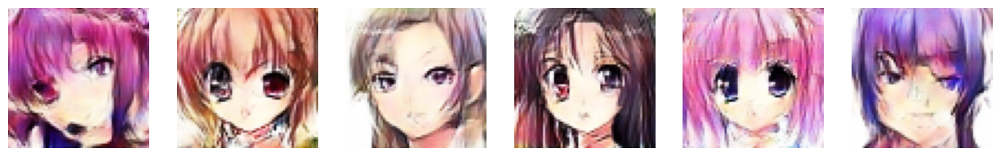

469/469 [==============================] - 72s 153ms/step - d_loss: 0.6893 - g_loss: 0.6970 - d_accuracy: 0.5311 - g_accuracy: 0.3819
Epoch 32/40
469/469 [==============================] - ETA: 0s - d_loss: 0.6899 - g_loss: 0.6987 - d_accuracy: 0.5285 - g_accuracy: 0.3428

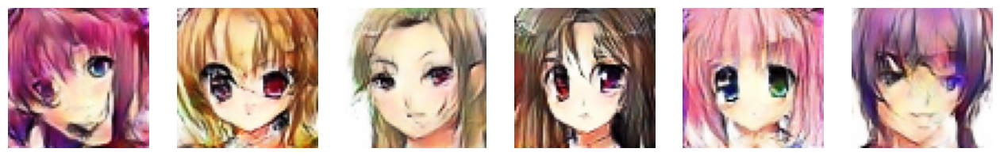

469/469 [==============================] - 72s 152ms/step - d_loss: 0.6899 - g_loss: 0.6987 - d_accuracy: 0.5285 - g_accuracy: 0.3428
Epoch 33/40
469/469 [==============================] - ETA: 0s - d_loss: 0.6901 - g_loss: 0.6986 - d_accuracy: 0.5266 - g_accuracy: 0.3351

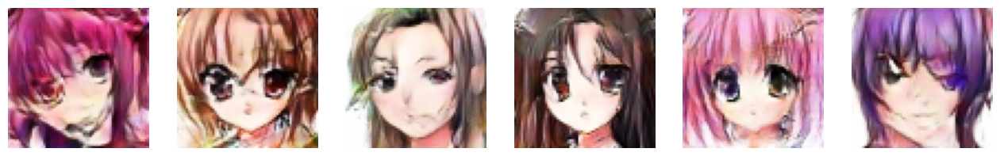

469/469 [==============================] - 72s 153ms/step - d_loss: 0.6901 - g_loss: 0.6986 - d_accuracy: 0.5266 - g_accuracy: 0.3351
Epoch 34/40
469/469 [==============================] - ETA: 0s - d_loss: 0.6910 - g_loss: 0.7007 - d_accuracy: 0.5250 - g_accuracy: 0.3257

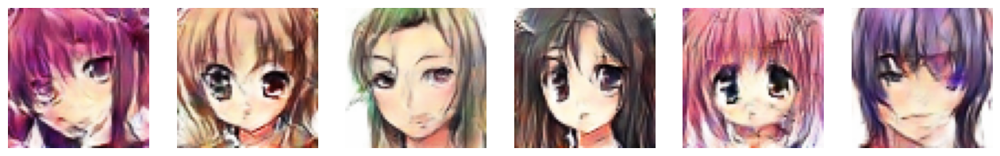

469/469 [==============================] - 72s 153ms/step - d_loss: 0.6910 - g_loss: 0.7007 - d_accuracy: 0.5250 - g_accuracy: 0.3257
Epoch 35/40
469/469 [==============================] - ETA: 0s - d_loss: 0.6901 - g_loss: 0.6982 - d_accuracy: 0.5258 - g_accuracy: 0.3328

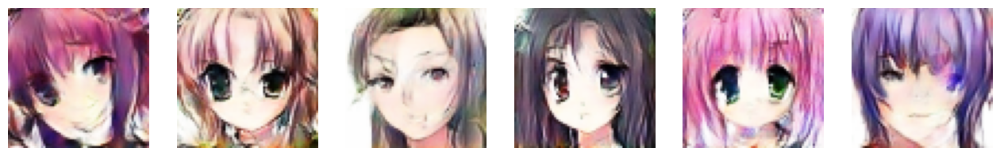

469/469 [==============================] - 71s 152ms/step - d_loss: 0.6901 - g_loss: 0.6982 - d_accuracy: 0.5258 - g_accuracy: 0.3328
Epoch 36/40
469/469 [==============================] - ETA: 0s - d_loss: 0.6910 - g_loss: 0.6998 - d_accuracy: 0.5205 - g_accuracy: 0.3089

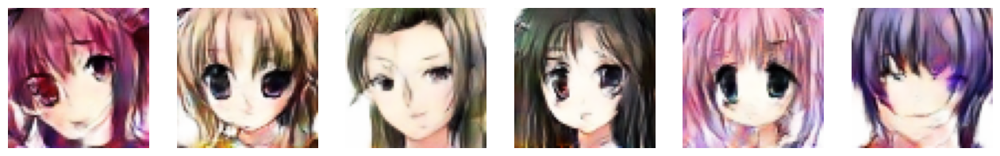

469/469 [==============================] - 72s 152ms/step - d_loss: 0.6910 - g_loss: 0.6998 - d_accuracy: 0.5205 - g_accuracy: 0.3089
Epoch 37/40
469/469 [==============================] - ETA: 0s - d_loss: 0.6942 - g_loss: 0.7014 - d_accuracy: 0.5135 - g_accuracy: 0.3142

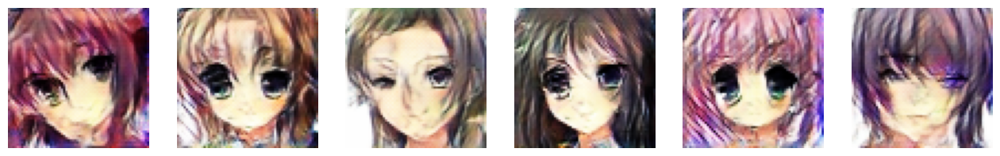

469/469 [==============================] - 72s 153ms/step - d_loss: 0.6942 - g_loss: 0.7014 - d_accuracy: 0.5135 - g_accuracy: 0.3142
Epoch 38/40
469/469 [==============================] - ETA: 0s - d_loss: 0.6942 - g_loss: 0.7026 - d_accuracy: 0.4911 - g_accuracy: 0.1991

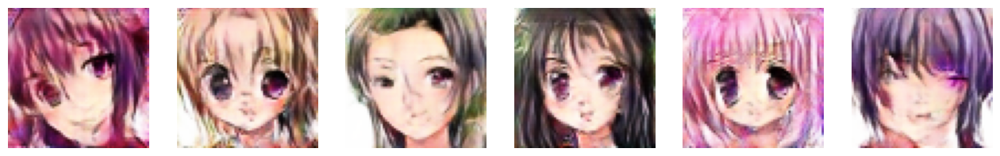

469/469 [==============================] - 72s 153ms/step - d_loss: 0.6942 - g_loss: 0.7026 - d_accuracy: 0.4911 - g_accuracy: 0.1991
Epoch 39/40
469/469 [==============================] - ETA: 0s - d_loss: 0.6926 - g_loss: 0.6959 - d_accuracy: 0.5080 - g_accuracy: 0.2974

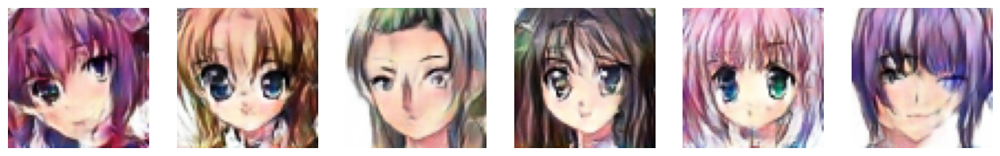

469/469 [==============================] - 71s 152ms/step - d_loss: 0.6926 - g_loss: 0.6959 - d_accuracy: 0.5080 - g_accuracy: 0.2974
Epoch 40/40
469/469 [==============================] - ETA: 0s - d_loss: 0.6907 - g_loss: 0.6958 - d_accuracy: 0.5267 - g_accuracy: 0.3674

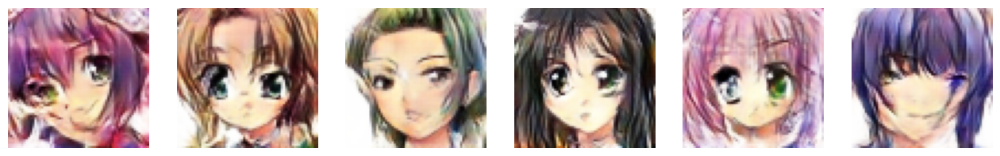

469/469 [==============================] - 71s 152ms/step - d_loss: 0.6907 - g_loss: 0.6958 - d_accuracy: 0.5267 - g_accuracy: 0.3674


In [ ]:
model=GAN(Generator,Discriminator,noise_dim)
model.compile(gen_opt=tf.keras.optimizers.Adam(learning_rate=5e-4,beta_1=0.5),dis_opt=tf.keras.optimizers.Adam(learning_rate=9e-5,beta_1=0.5),gen_loss=generator_loss,dis_loss=discriminator_loss)
hist=model.fit(images,epochs=40,callbacks=[GANMonitor(latent_dim=noise_dim)],batch_size=128)

# **Visualizing generator's and discriminator's accuracy and loss during learning**

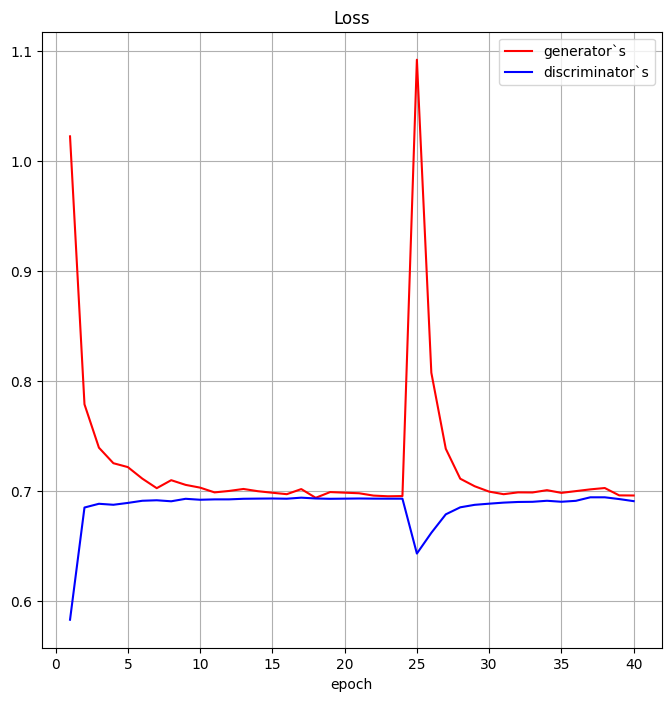

In [ ]:
g_loss=hist.history['g_loss']
d_loss=hist.history['d_loss']
ep=[i for i in range(1,len(g_loss)+1)]
fig=plt.figure(figsize=(8,8))
ax=fig.add_subplot(1,1,1)
ax.set_title('Loss')
ax.set_xlabel('epoch')
ax.plot(ep,g_loss,color='r',label='generator`s')
ax.plot(ep,d_loss,color='b',label='discriminator`s')
ax.legend()
ax.grid()
plt.show()

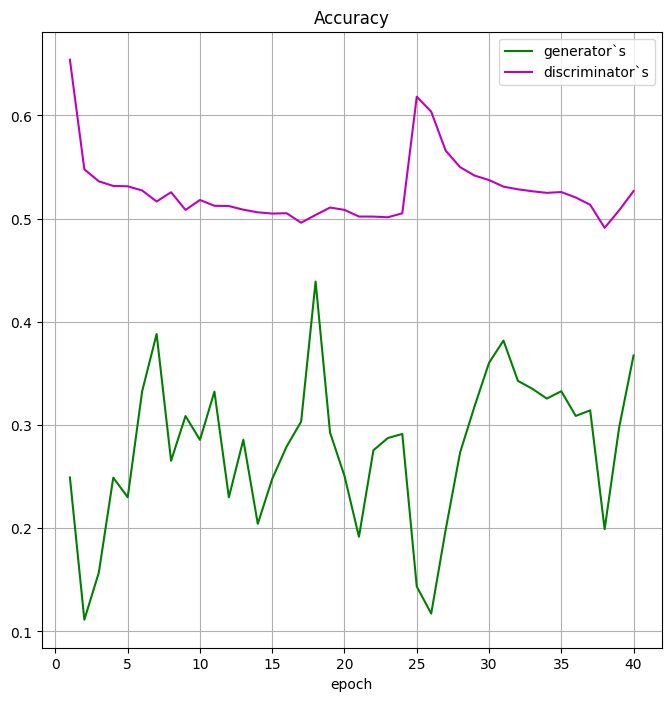

In [ ]:
g_accuracy=hist.history['g_accuracy']
d_accuracy=hist.history['d_accuracy']
ep=[i for i in range(1,len(g_accuracy)+1)]
fig=plt.figure(figsize=(8,8))
ax=fig.add_subplot(1,1,1)
ax.set_title('Accuracy')
ax.set_xlabel('epoch')
ax.plot(ep,g_accuracy,color='g',label='generator`s')
ax.plot(ep,d_accuracy,color='m',label='discriminator`s')
ax.legend()
ax.grid()
plt.show()

# **Visualizing examples of generated images**

1/1 [==============================] - 0s 203ms/step


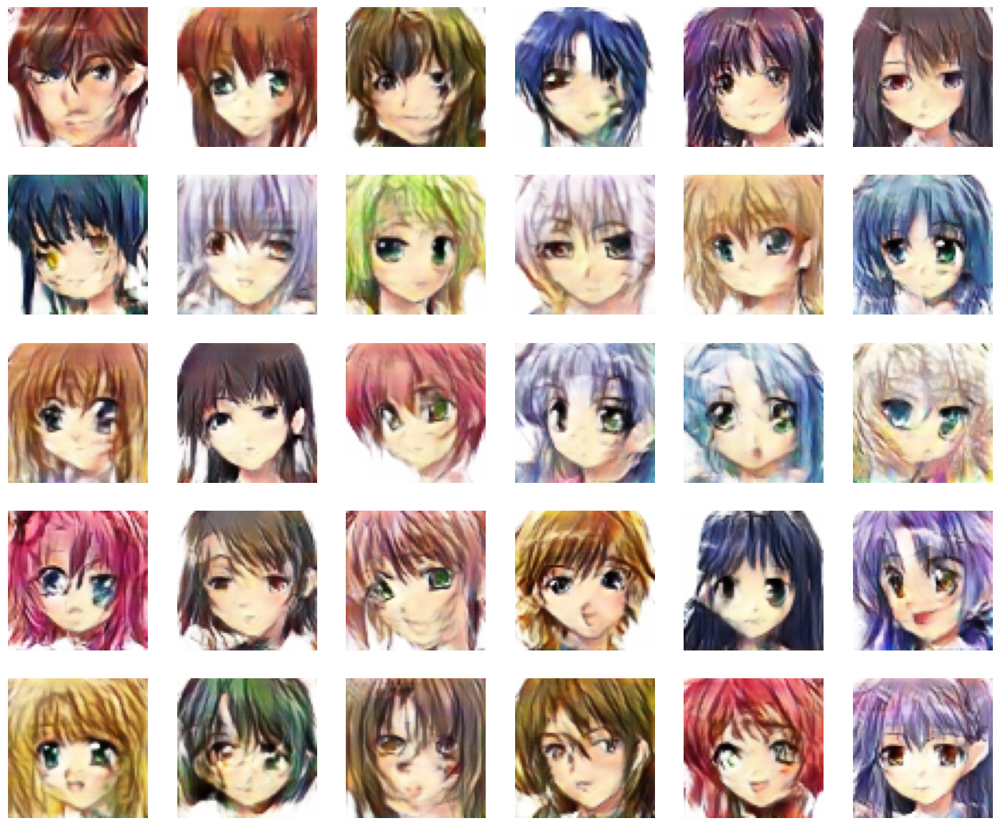

In [ ]:
num_images=30
fig=plt.figure(figsize=(16,16))
noise=tf.random.normal(mean=0,stddev=1,shape=[num_images,noise_dim])
pred_images=model.generator.predict(noise)
for i in range(num_images):
    ax=fig.add_subplot((num_images//6)+1,6,i+1)
    ax.axis('off')
    ax.imshow(pred_images[i])
plt.show()

# **Additional training**

Epoch 1/30
469/469 [==============================] - ETA: 0s - d_loss: 0.6908 - g_loss: 0.6975 - d_accuracy: 0.5234 - g_accuracy: 0.3234

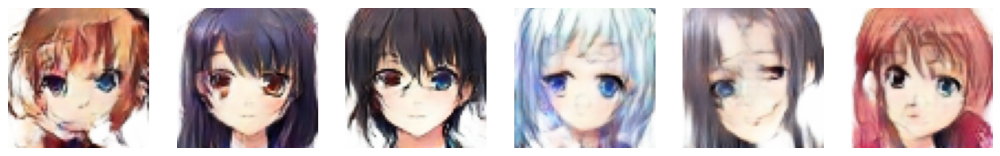

469/469 [==============================] - 71s 152ms/step - d_loss: 0.6908 - g_loss: 0.6975 - d_accuracy: 0.5234 - g_accuracy: 0.3234
Epoch 2/30
469/469 [==============================] - ETA: 0s - d_loss: 0.6898 - g_loss: 0.6996 - d_accuracy: 0.5274 - g_accuracy: 0.3004

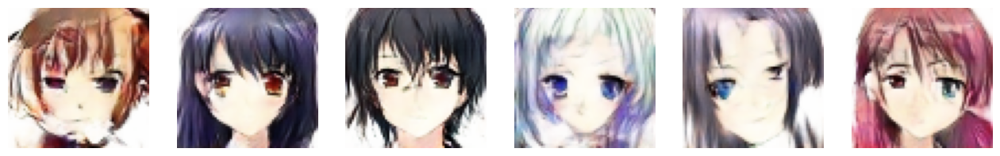

469/469 [==============================] - 72s 152ms/step - d_loss: 0.6898 - g_loss: 0.6996 - d_accuracy: 0.5274 - g_accuracy: 0.3004
Epoch 3/30
469/469 [==============================] - ETA: 0s - d_loss: 0.6904 - g_loss: 0.7010 - d_accuracy: 0.5250 - g_accuracy: 0.2846

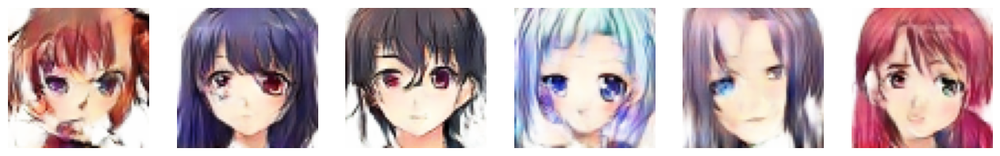

469/469 [==============================] - 71s 152ms/step - d_loss: 0.6904 - g_loss: 0.7010 - d_accuracy: 0.5250 - g_accuracy: 0.2846
Epoch 4/30
469/469 [==============================] - ETA: 0s - d_loss: 0.6921 - g_loss: 0.7066 - d_accuracy: 0.5132 - g_accuracy: 0.1989

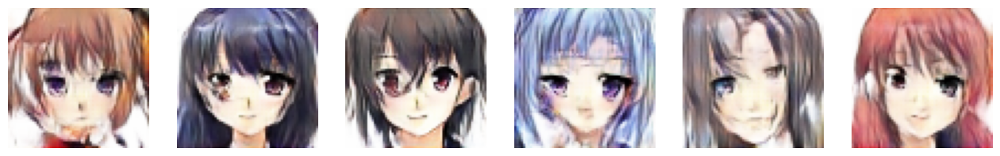

469/469 [==============================] - 71s 152ms/step - d_loss: 0.6921 - g_loss: 0.7066 - d_accuracy: 0.5132 - g_accuracy: 0.1989
Epoch 5/30
469/469 [==============================] - ETA: 0s - d_loss: 0.6911 - g_loss: 0.6980 - d_accuracy: 0.5192 - g_accuracy: 0.2926

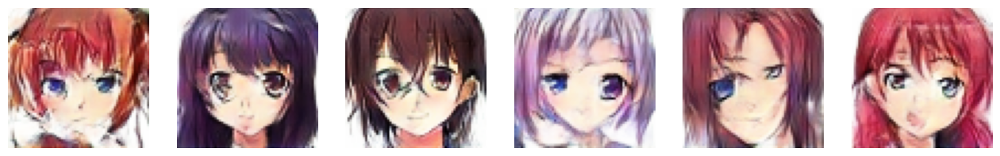

469/469 [==============================] - 71s 152ms/step - d_loss: 0.6911 - g_loss: 0.6980 - d_accuracy: 0.5192 - g_accuracy: 0.2926
Epoch 6/30
469/469 [==============================] - ETA: 0s - d_loss: 0.6893 - g_loss: 0.6992 - d_accuracy: 0.5328 - g_accuracy: 0.3082

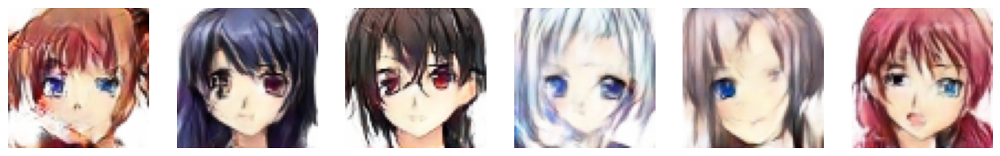

469/469 [==============================] - 71s 152ms/step - d_loss: 0.6893 - g_loss: 0.6992 - d_accuracy: 0.5328 - g_accuracy: 0.3082
Epoch 7/30
469/469 [==============================] - ETA: 0s - d_loss: 0.6901 - g_loss: 0.7024 - d_accuracy: 0.5291 - g_accuracy: 0.3018

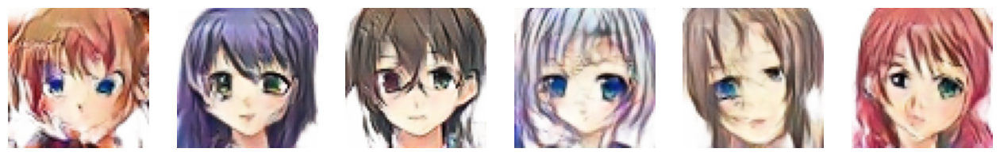

469/469 [==============================] - 71s 152ms/step - d_loss: 0.6901 - g_loss: 0.7024 - d_accuracy: 0.5291 - g_accuracy: 0.3018
Epoch 8/30
469/469 [==============================] - ETA: 0s - d_loss: 0.6899 - g_loss: 0.7013 - d_accuracy: 0.5260 - g_accuracy: 0.2863

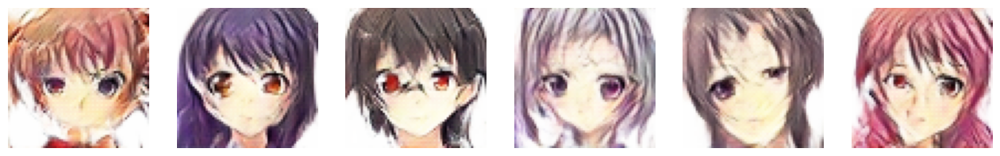

469/469 [==============================] - 71s 152ms/step - d_loss: 0.6899 - g_loss: 0.7013 - d_accuracy: 0.5260 - g_accuracy: 0.2863
Epoch 9/30
469/469 [==============================] - ETA: 0s - d_loss: 0.6898 - g_loss: 0.7029 - d_accuracy: 0.5272 - g_accuracy: 0.2841

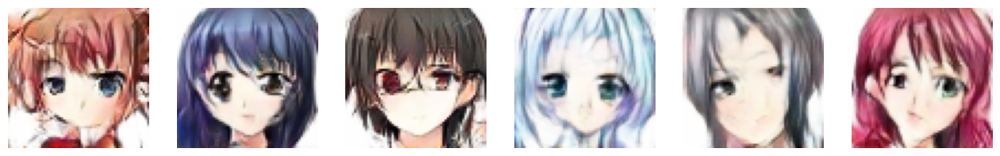

469/469 [==============================] - 71s 152ms/step - d_loss: 0.6898 - g_loss: 0.7029 - d_accuracy: 0.5272 - g_accuracy: 0.2841
Epoch 10/30
469/469 [==============================] - ETA: 0s - d_loss: 0.6931 - g_loss: 0.7108 - d_accuracy: 0.5118 - g_accuracy: 0.1688

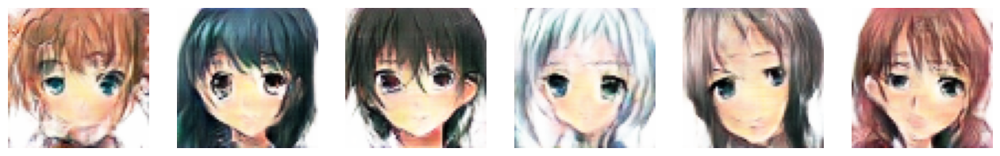

469/469 [==============================] - 71s 152ms/step - d_loss: 0.6931 - g_loss: 0.7108 - d_accuracy: 0.5118 - g_accuracy: 0.1688
Epoch 11/30
469/469 [==============================] - ETA: 0s - d_loss: 0.6906 - g_loss: 0.6989 - d_accuracy: 0.5187 - g_accuracy: 0.2825

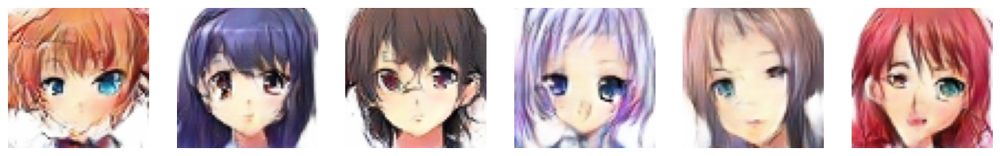

469/469 [==============================] - 72s 153ms/step - d_loss: 0.6906 - g_loss: 0.6989 - d_accuracy: 0.5187 - g_accuracy: 0.2825
Epoch 12/30
469/469 [==============================] - ETA: 0s - d_loss: 0.6895 - g_loss: 0.6989 - d_accuracy: 0.5277 - g_accuracy: 0.3141

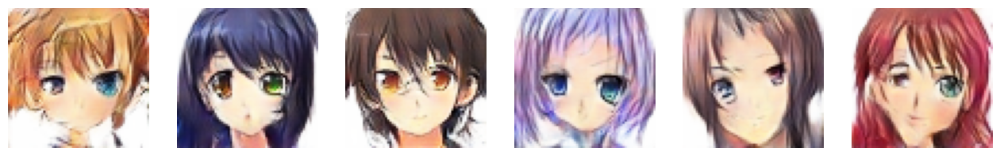

469/469 [==============================] - 71s 152ms/step - d_loss: 0.6895 - g_loss: 0.6989 - d_accuracy: 0.5277 - g_accuracy: 0.3141
Epoch 13/30
469/469 [==============================] - ETA: 0s - d_loss: 0.6891 - g_loss: 0.7020 - d_accuracy: 0.5286 - g_accuracy: 0.2647

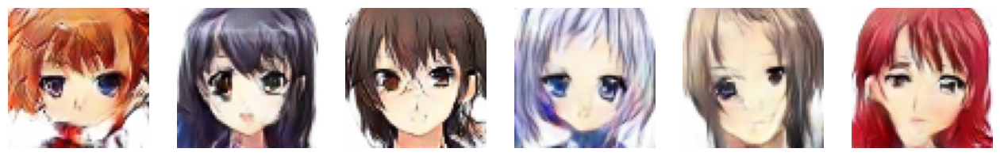

469/469 [==============================] - 71s 152ms/step - d_loss: 0.6891 - g_loss: 0.7020 - d_accuracy: 0.5286 - g_accuracy: 0.2647
Epoch 14/30
469/469 [==============================] - ETA: 0s - d_loss: 0.6896 - g_loss: 0.7051 - d_accuracy: 0.5279 - g_accuracy: 0.2612

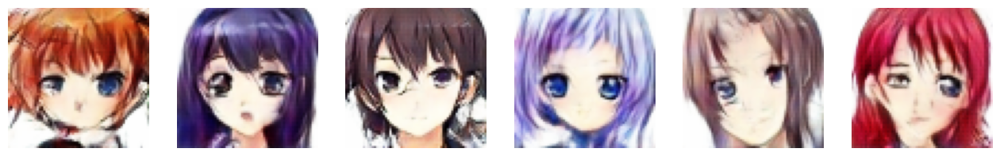

469/469 [==============================] - 71s 152ms/step - d_loss: 0.6896 - g_loss: 0.7051 - d_accuracy: 0.5279 - g_accuracy: 0.2612
Epoch 15/30
469/469 [==============================] - ETA: 0s - d_loss: 0.6883 - g_loss: 0.7014 - d_accuracy: 0.5339 - g_accuracy: 0.2966

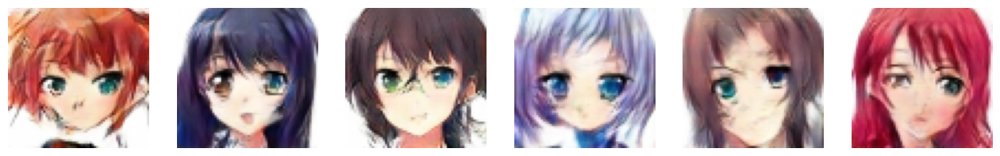

469/469 [==============================] - 71s 152ms/step - d_loss: 0.6883 - g_loss: 0.7014 - d_accuracy: 0.5339 - g_accuracy: 0.2966
Epoch 16/30
469/469 [==============================] - ETA: 0s - d_loss: 0.6890 - g_loss: 0.7055 - d_accuracy: 0.5306 - g_accuracy: 0.2664

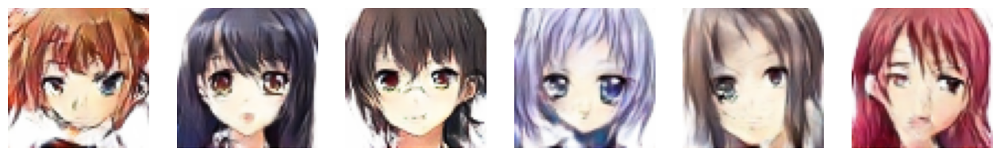

469/469 [==============================] - 71s 152ms/step - d_loss: 0.6890 - g_loss: 0.7055 - d_accuracy: 0.5306 - g_accuracy: 0.2664
Epoch 17/30
469/469 [==============================] - ETA: 0s - d_loss: 0.6883 - g_loss: 0.7041 - d_accuracy: 0.5324 - g_accuracy: 0.2720

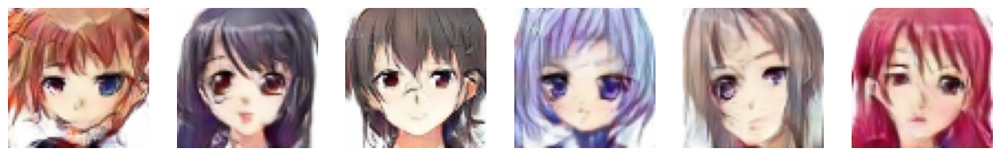

469/469 [==============================] - 72s 153ms/step - d_loss: 0.6883 - g_loss: 0.7041 - d_accuracy: 0.5324 - g_accuracy: 0.2720
Epoch 18/30
469/469 [==============================] - ETA: 0s - d_loss: 0.6887 - g_loss: 0.7057 - d_accuracy: 0.5315 - g_accuracy: 0.2583

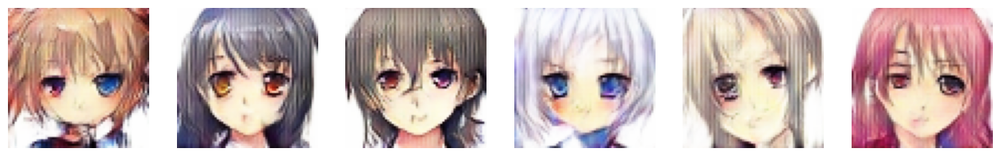

469/469 [==============================] - 72s 153ms/step - d_loss: 0.6887 - g_loss: 0.7057 - d_accuracy: 0.5315 - g_accuracy: 0.2583
Epoch 19/30
469/469 [==============================] - ETA: 0s - d_loss: 0.6878 - g_loss: 0.7049 - d_accuracy: 0.5332 - g_accuracy: 0.2524

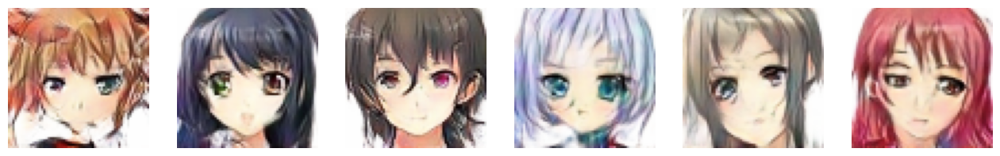

469/469 [==============================] - 71s 152ms/step - d_loss: 0.6878 - g_loss: 0.7049 - d_accuracy: 0.5332 - g_accuracy: 0.2524
Epoch 20/30
469/469 [==============================] - ETA: 0s - d_loss: 0.6873 - g_loss: 0.7068 - d_accuracy: 0.5327 - g_accuracy: 0.2466

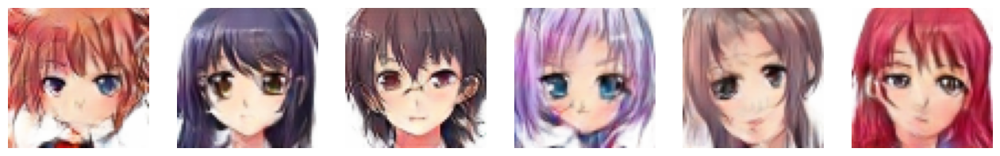

469/469 [==============================] - 71s 152ms/step - d_loss: 0.6873 - g_loss: 0.7068 - d_accuracy: 0.5327 - g_accuracy: 0.2466
Epoch 21/30
469/469 [==============================] - ETA: 0s - d_loss: 0.6886 - g_loss: 0.7081 - d_accuracy: 0.5327 - g_accuracy: 0.2300

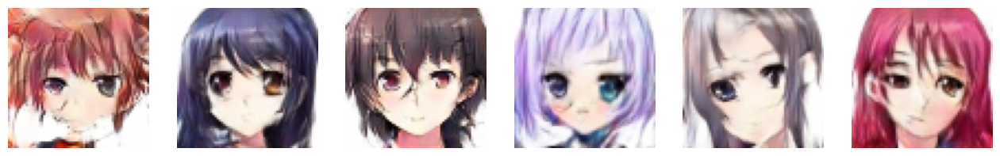

469/469 [==============================] - 71s 152ms/step - d_loss: 0.6886 - g_loss: 0.7081 - d_accuracy: 0.5327 - g_accuracy: 0.2300
Epoch 22/30
469/469 [==============================] - ETA: 0s - d_loss: 0.6871 - g_loss: 0.7078 - d_accuracy: 0.5372 - g_accuracy: 0.2370

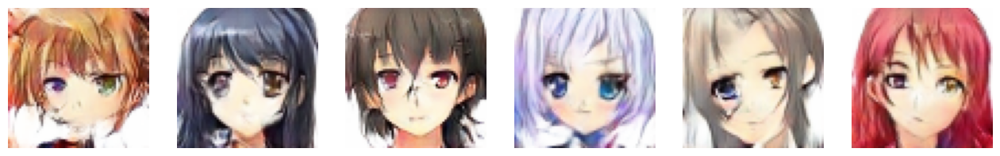

469/469 [==============================] - 71s 152ms/step - d_loss: 0.6871 - g_loss: 0.7078 - d_accuracy: 0.5372 - g_accuracy: 0.2370
Epoch 23/30
469/469 [==============================] - ETA: 0s - d_loss: 0.6868 - g_loss: 0.7096 - d_accuracy: 0.5385 - g_accuracy: 0.2329

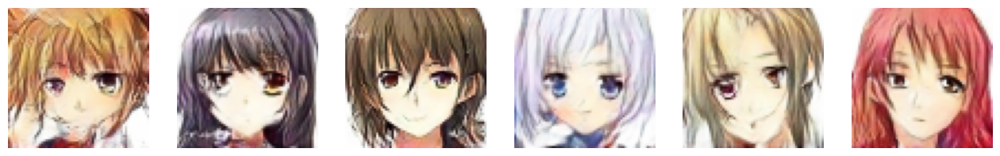

469/469 [==============================] - 71s 152ms/step - d_loss: 0.6868 - g_loss: 0.7096 - d_accuracy: 0.5385 - g_accuracy: 0.2329
Epoch 24/30
469/469 [==============================] - ETA: 0s - d_loss: 0.6870 - g_loss: 0.7103 - d_accuracy: 0.5359 - g_accuracy: 0.2164

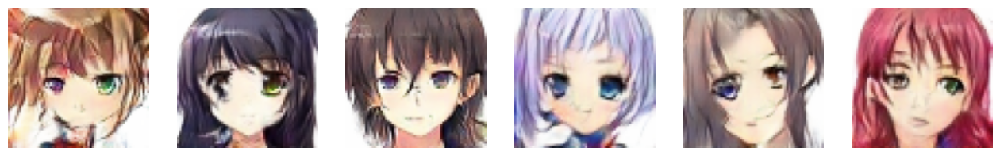

469/469 [==============================] - 72s 153ms/step - d_loss: 0.6870 - g_loss: 0.7103 - d_accuracy: 0.5359 - g_accuracy: 0.2164
Epoch 25/30
469/469 [==============================] - ETA: 0s - d_loss: 0.6878 - g_loss: 0.7129 - d_accuracy: 0.5327 - g_accuracy: 0.2069

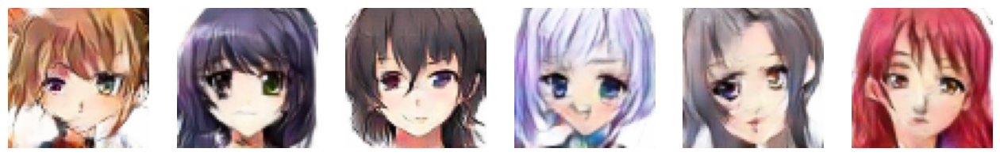

469/469 [==============================] - 71s 152ms/step - d_loss: 0.6878 - g_loss: 0.7129 - d_accuracy: 0.5327 - g_accuracy: 0.2069
Epoch 26/30
469/469 [==============================] - ETA: 0s - d_loss: 0.6883 - g_loss: 0.7136 - d_accuracy: 0.5344 - g_accuracy: 0.2217

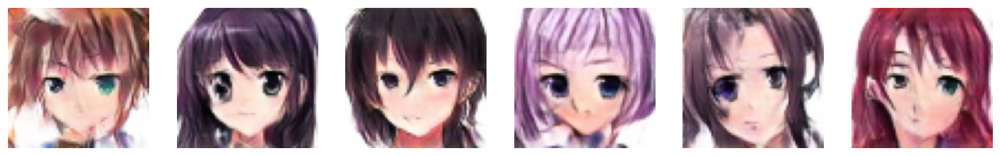

469/469 [==============================] - 71s 152ms/step - d_loss: 0.6883 - g_loss: 0.7136 - d_accuracy: 0.5344 - g_accuracy: 0.2217
Epoch 27/30
469/469 [==============================] - ETA: 0s - d_loss: 0.6898 - g_loss: 0.7094 - d_accuracy: 0.5242 - g_accuracy: 0.1952

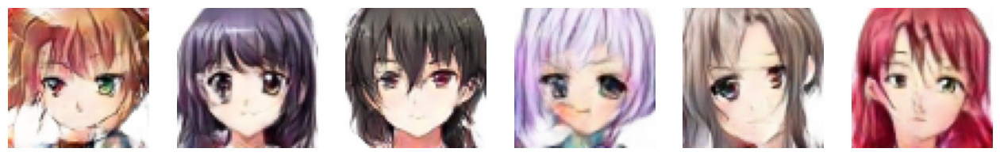

469/469 [==============================] - 71s 152ms/step - d_loss: 0.6898 - g_loss: 0.7094 - d_accuracy: 0.5242 - g_accuracy: 0.1952
Epoch 28/30
469/469 [==============================] - ETA: 0s - d_loss: 0.6854 - g_loss: 0.7069 - d_accuracy: 0.5410 - g_accuracy: 0.2478

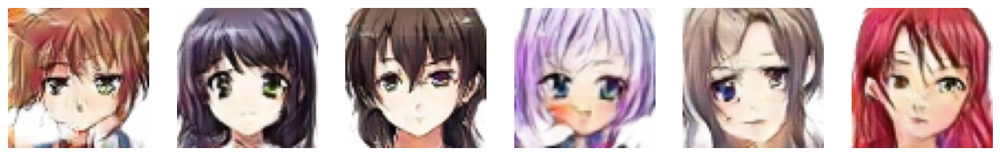

469/469 [==============================] - 71s 152ms/step - d_loss: 0.6854 - g_loss: 0.7069 - d_accuracy: 0.5410 - g_accuracy: 0.2478
Epoch 29/30
469/469 [==============================] - ETA: 0s - d_loss: 0.6892 - g_loss: 0.7172 - d_accuracy: 0.5264 - g_accuracy: 0.1461

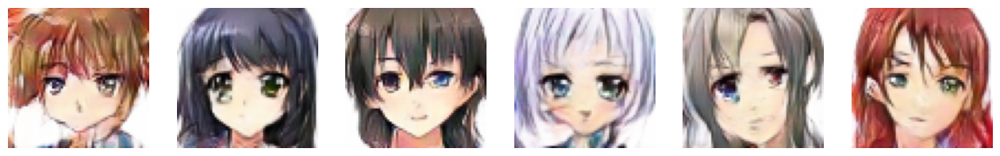

469/469 [==============================] - 71s 152ms/step - d_loss: 0.6892 - g_loss: 0.7172 - d_accuracy: 0.5264 - g_accuracy: 0.1461
Epoch 30/30
469/469 [==============================] - ETA: 0s - d_loss: 0.6850 - g_loss: 0.7080 - d_accuracy: 0.5434 - g_accuracy: 0.2411

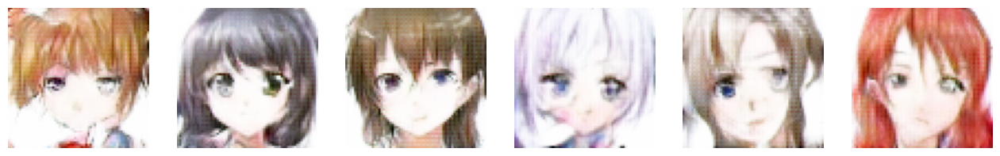

469/469 [==============================] - 71s 152ms/step - d_loss: 0.6850 - g_loss: 0.7080 - d_accuracy: 0.5434 - g_accuracy: 0.2411


In [ ]:
hist=model.fit(images,epochs=30,callbacks=[GANMonitor(latent_dim=noise_dim)],batch_size=128)

# **Visualizing model's accuracy and loss during additional training**

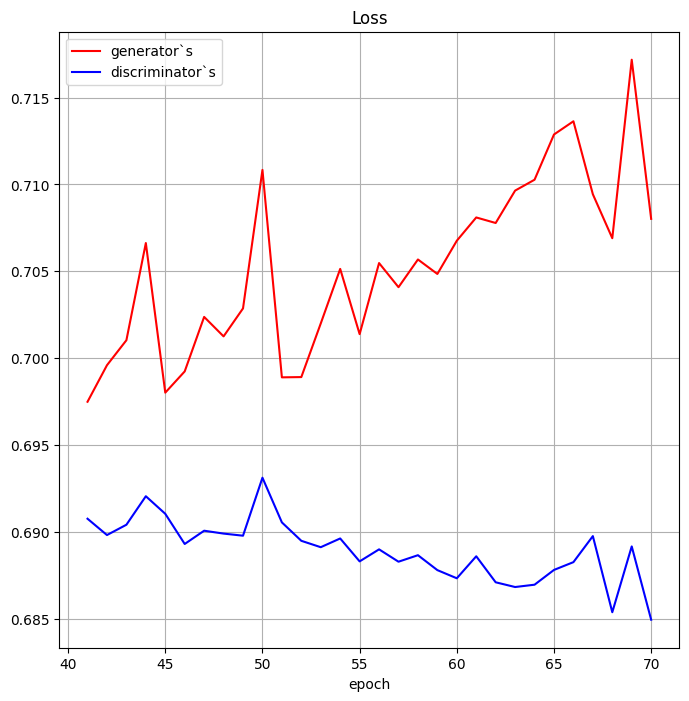

In [ ]:
g_loss=hist.history['g_loss']
d_loss=hist.history['d_loss']
ep=[i for i in range(41,len(g_loss)+41)]
fig=plt.figure(figsize=(8,8))
ax=fig.add_subplot(1,1,1)
ax.set_title('Loss')
ax.set_xlabel('epoch')
ax.plot(ep,g_loss,color='r',label='generator`s')
ax.plot(ep,d_loss,color='b',label='discriminator`s')
ax.legend()
ax.grid()
plt.show()

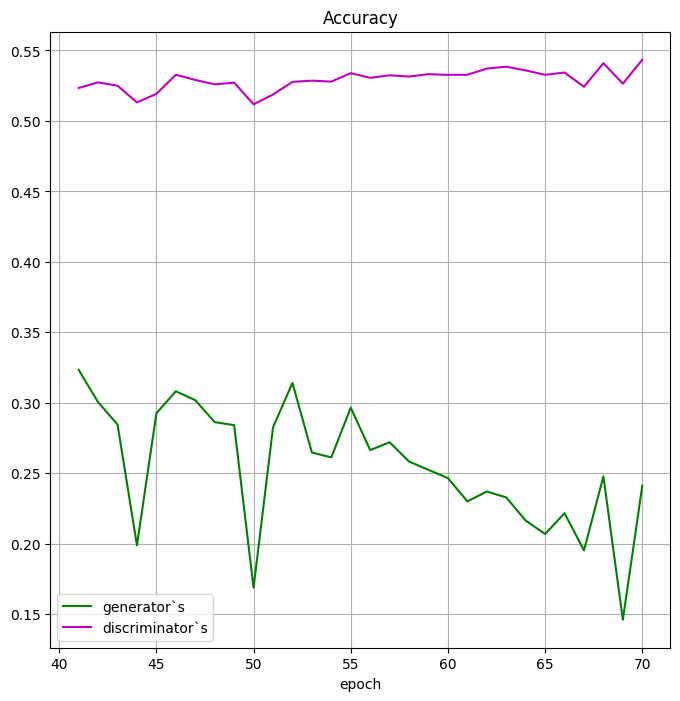

In [ ]:
g_accuracy=hist.history['g_accuracy']
d_accuracy=hist.history['d_accuracy']
ep=[i for i in range(41,len(g_accuracy)+41)]
fig=plt.figure(figsize=(8,8))
ax=fig.add_subplot(1,1,1)
ax.set_title('Accuracy')
ax.set_xlabel('epoch')
ax.plot(ep,g_accuracy,color='g',label='generator`s')
ax.plot(ep,d_accuracy,color='m',label='discriminator`s')
ax.legend()
ax.grid()
plt.show()

# **Visualizing some examples of generated images after additional training**

1/1 [==============================] - 0s 19ms/step


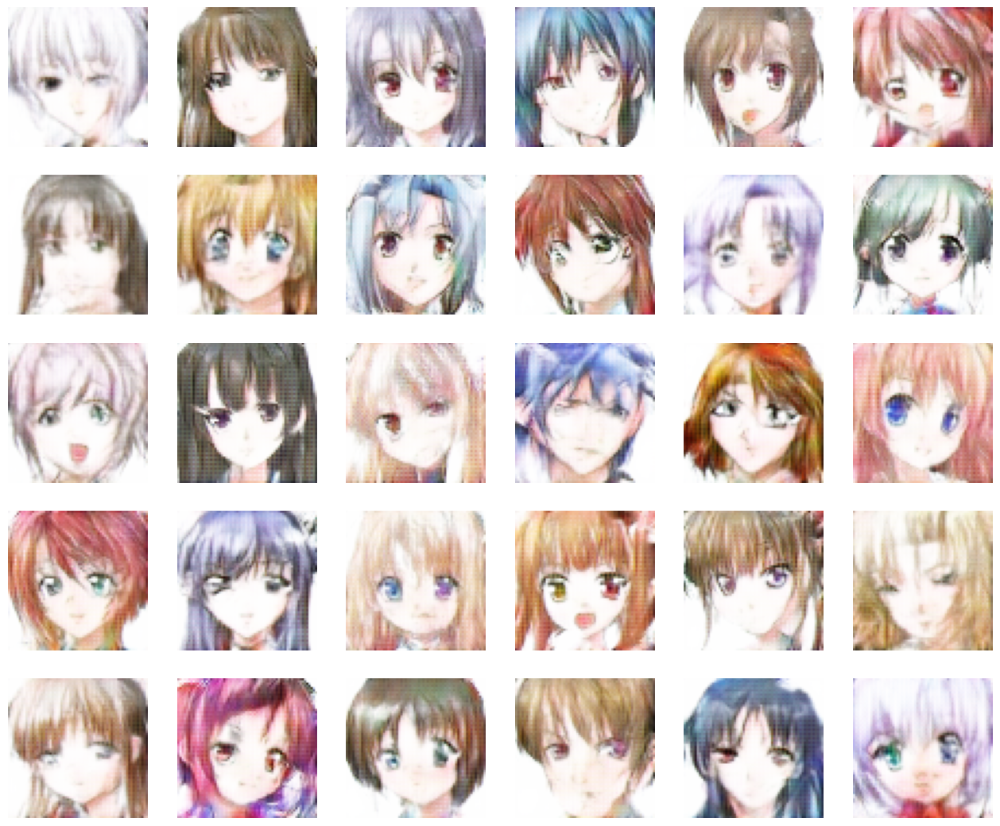

In [ ]:
num_images=30
fig=plt.figure(figsize=(16,16))
noise=tf.random.normal(mean=0,stddev=1,shape=[num_images,noise_dim])
pred_images=model.generator.predict(noise)
for i in range(num_images):
    ax=fig.add_subplot((num_images//6)+1,6,i+1)
    ax.axis('off')
    ax.imshow(pred_images[i])
plt.show()